This is some initial setup tried on 6/06/2023 to process the raw data of "primary.tsv" from SuperCon

## **Basic** **setup**.

In [1]:
# import libraries we will need
!pip install pymatgen
!git clone https://github.com/aimat-lab/3DSC.git

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import copy
import pymatgen

fatal: destination path '3DSC' already exists and is not an empty directory.


In [2]:
# Load in the raw data from the Hoffman lab drive
df = pd.read_csv("C:/Users/Droor/OneDrive - Harvard University/Desktop/Master Folder/College (2022-2026)/Hoffman summer/git-clone/superconductors-ml/datasets/raw-data-primary.tsv", sep='\t', header = 1)
df.name = "raw-mdr-data"

In [3]:
# remove one weird extra row of parameter info and rename cols
df = df.drop([df.index[0]])
df.rename(columns = {'common formula of materials': 'common formula', 'Tc (of this sample) recommended':'Tc'}, inplace = True)
df['Tc'] = df['Tc'].astype(float)
df.shape

(26321, 7)

In [4]:
df["common formula"].shape

(26321,)

In [5]:
df.dtypes

data number                  object
common formula               object
chemical formula             object
common name of structure     object
unit of Tc                   object
Tc                          float64
journal                      object
dtype: object

The dataset has 26322 entries of materials, with only 25032 entries having "common formulas" (7350 unique common formulae), but all entries have "chemical formulae" and Tc's associated. This is good. We are most interested in the chemical formula (and looking at how we can find each unique material from the chemical formulae list), and the Tc column. The common formula, the structure (unreliable), the unit of Tc (all K anyway), and the journal.

## **A: "common formula" Data Exploration**

In [6]:
# I want to see what the statistics are rudimentarily if I were just to treat each unique common formula as a different material.
# Many assumptions here are off, obviously.
df2 = df[['common formula', 'Tc']]
df2 = df2.sort_values(by=['Tc'], ascending=False)

In [ ]:
df2['Tc' ==]

I believe the first 6 are wrong (Tc < 203K), but then, we note that the H2S ones are under huge pressure. So obviously not all entries are of same pressure.

In [7]:
df2.describe()

,Tc
count,26321.000000
mean,32.678173
std,34.408781
min,0.000000
25%,4.510000
50%,17.100000
75%,58.450000
max,323.000000


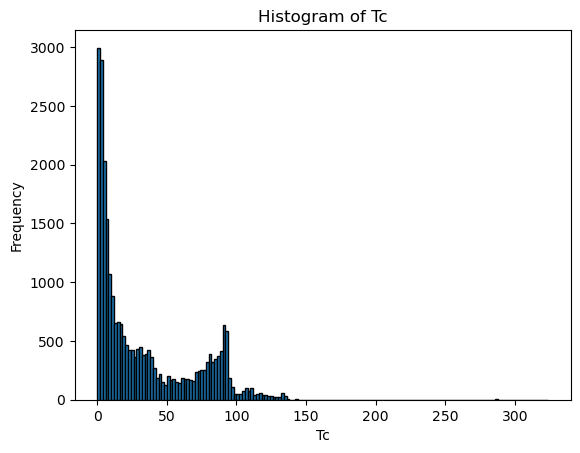

In [8]:
# Plot a single histogram of Tc
# Set the bin width and range
bin_width = 2
bin_range = range(int(df['Tc'].min()), int(df['Tc'].max()) + bin_width, bin_width)

# Create the histogram
plt.hist(df['Tc'], bins=bin_range, edgecolor='black')

# Set the plot labels and title
plt.xlabel('Tc')
plt.ylabel('Frequency')
plt.title('Histogram of Tc')

# Display the plot
plt.show()

<Axes: ylabel='Frequency'>

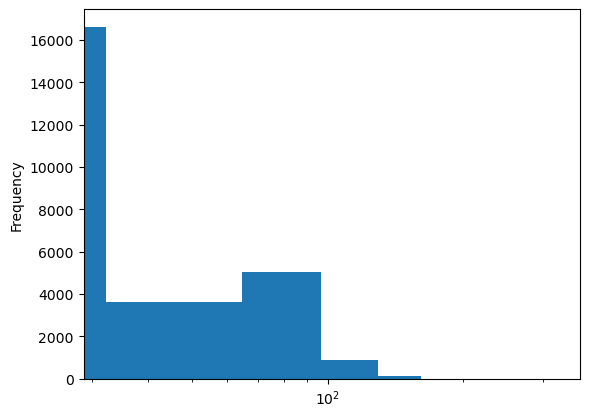

In [9]:
df['Tc'].plot(kind='hist', logx=True)

## **B: creating a mapping of "chemical formula" to material using constituent elements by ChemParse**

### **Install necessary libraries**

In [15]:
!pip install chemparse
!pip install periodictable

import chemparse
import periodictable

In [16]:
# Define a function to parse the formula using chemparse
def parse_formula(formula):
    try:
        return chemparse.parse_formula(formula)
    except TypeError:
        return None

In [17]:
# Apply the function to the 'chemical_formula' column and assign the results to a new column 'parsed_formula'
df['parsed_formula'] = df['common formula'].apply(parse_formula)

# This does a pretty terrible job. But maybe I can see how many cuprates there are, and fe-based. This is all very shaky though.

In [18]:
# Need this cell a lot. Creates our basic database.
df_chem_form = df[['chemical formula', 'Tc']]
df_chem_form.rename(columns={"chemical formula": "supercon_formula", "Tc": "Tc"}, inplace=True)
df_chem_form.insert(0, "sc_id", df.reset_index().index + 1)
df_chem_form.head()

C:\Users\Droor\AppData\Local\Temp\ipykernel_11460\2950997486.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_chem_form.rename(columns={"chemical formula": "supercon_formula", "Tc": "Tc"}, inplace=True)


,sc_id,supercon_formula,Tc
1,1,Ba0.2La1.8Cu1O4-Y,29.0
2,2,Ba0.1La1.9Ag0.1Cu0.9O4-Y,26.0
3,3,Ba0.1La1.9Cu1O4-Y,19.0
4,4,Ba0.15La1.85Cu1O4-Y,22.0
5,5,Ba0.3La1.7Cu1O4-Y,23.0


In [19]:
# Create an list that will store strings of edge-cases.
edgecases = []

### **An aside: basic analysis that ChemParse makes possible**

We can do a rudimentary estimate of cuprates and Fe-based compounds:

In [20]:
# Initialize the count of cuprates
count = 0
total = 0

# Iterate over the DataFrame rows
for index, row in df_chem_form.iterrows():
    parsed_formula = parse_formula(df_chem_form['supercon_formula'][index])

    # Check if 'Cu' and 'O' elements exist in the parsed formula and their counts are non-zero
    if 'Cu' in parsed_formula and 'O' in parsed_formula and parsed_formula['Cu'] > 0 and parsed_formula['O'] > 0:
        count += 1
    total += 1

print("The percentage of 'cuprates' in the database is: " + str(100*count/total))

The percentage of 'cuprates' in the database is: 41.03187568861365


In [21]:
# Initialize the count of Fe-based
count = 0
total = 0

# Iterate over the DataFrame rows
for index, row in df.iterrows():
    parsed_formula = parse_formula(df_chem_form['supercon_formula'][index])

    # Check if 'Cu' and 'O' elements exist in the parsed formula and their counts are non-zero
    if 'Fe' in parsed_formula and parsed_formula['Fe'] > 0:
        count += 1
    total += 1

print("The percentage of 'Fe-based' in the database is: " + str(100*count/total))

The percentage of 'Fe-based' in the database is: 11.165989134151438


### **Datacleaning: we want to get to a point where we have a structure we can use with MaterialsProject**

#### Step 1: Address stoichiometric/doping 'uncertainty' expressed as +-xyz (22472)

In [ ]:
# Edge case of Sm1Ba-1Cu3O6.94 still not fixed. Only remove the trailing character if comes after an O?

In [22]:
# !!! This is the main cleaning. We must do a number of other filters before chemparsing.
df_chem_form_clean = df_chem_form

# Remove 6 entries with too high a Tc
df_chem_form_clean = df_chem_form_clean[(df_chem_form_clean.Tc <= 204)]

# Remove 89 entries with a Tc = 0.00
df_chem_form = df_chem_form_clean[(df_chem_form_clean.Tc != 0)]

# Remove the +-x, +-z, -+y problems at the end. First make a list that will store the renamed compounds.
clean_formulas = []

def remove_trail(formula):
    minus_index = formula.find('-')
    plus_index = formula.find('+')

    if plus_index == -1 and minus_index == -1:
        return formula
    elif minus_index == -1:
        result = plus_index
    elif plus_index == -1:
        result = minus_index
    else:
        result = min(plus_index, minus_index)
    return formula[:result]

# Iterate and add an entry that removes anything after/incl. a '-' or '+'
for index, row in df_chem_form_clean.iterrows():
    formula = row['supercon_formula']
    clean_formulas.append(remove_trail(formula))

df_chem_form_clean['clean_formula'] = clean_formulas

In [23]:
print(df_chem_form_clean[df_chem_form_clean['clean_formula'].str.endswith(('x', 'y', 'z', 'X', 'Y', 'Z'))])

       sc_id               supercon_formula     Tc  \
30        30                   Yb16Ba1Cu2Oz  76.90   
31        31                Yb1.8Ba0.2Cu1Oz  65.30   
32        32                    Yb6Ba1Cu1Oz  78.60   
33        33  Yb1.62La0.18Ba0.18Sr0.02Cu1Oz  79.30   
34        34                 Y0.4Ba0.6Cu1OX  90.00   
...      ...                            ...    ...   
24350  24350        Ru0.97Re0.03Sr2Gd1Cu2Oz   9.96   
24351  24351        Ru0.94Re0.06Sr2Gd1Cu2Oz   9.86   
24389  24389        Nb0.8Ti0.1Sr2Eu1Cu2.1Oz  28.00   
24390  24390        Nb0.7Ti0.1Sr2Eu1Cu2.2Oz  30.00   
24391  24391        Nb0.5Ti0.1Sr2Eu1Cu2.4Oz  30.00   

                       clean_formula  
30                      Yb16Ba1Cu2Oz  
31                   Yb1.8Ba0.2Cu1Oz  
32                       Yb6Ba1Cu1Oz  
33     Yb1.62La0.18Ba0.18Sr0.02Cu1Oz  
34                    Y0.4Ba0.6Cu1OX  
...                              ...  
24350        Ru0.97Re0.03Sr2Gd1Cu2Oz  
24351        Ru0.94Re0.06Sr2Gd1Cu2Oz  


In [24]:
print((df_chem_form[(df_chem_form.Tc >= 204)]))

Empty DataFrame
Columns: [sc_id, supercon_formula, Tc]
Index: []


So there are potentially 2117 entries to remove because they have an unknown oxygen count at the end.

Jason, might you make a recommendation of how to deal with these cases? For now, I will delete them.

In [25]:
# Delete all entries that have x/y/z at end still ('loose variable').
df_chem_form_clean.drop(df_chem_form_clean[df_chem_form_clean['clean_formula'].str.endswith(('x', 'y', 'z', 'X', 'Y', 'Z'))].index, inplace = True)
df_chem_form_clean.shape

(24198, 4)

In [26]:
# edge cases found:
# Bi1.6Pb0.4Sr2Ca2Cu3F0.8Oz-0.8  Not sure what this one means. UPDATE: Fluorine and Oxygen add up to z. But it will also show up in endsPM_clean_df. So it will be deleted from final set.
edgecases.append("Bi1.6Pb0.4Sr2Ca2Cu3F0.8Oz-0.8")
edgecases.append("Y1Ba2Cu4O8+-Z")

Here we could introduce new rules if wanted. Eg. restrictions on the number of atoms.

In [27]:
df_chem_form_clean.head(10000)

,sc_id,supercon_formula,Tc,clean_formula
1,1,Ba0.2La1.8Cu1O4-Y,29.00,Ba0.2La1.8Cu1O4
2,2,Ba0.1La1.9Ag0.1Cu0.9O4-Y,26.00,Ba0.1La1.9Ag0.1Cu0.9O4
3,3,Ba0.1La1.9Cu1O4-Y,19.00,Ba0.1La1.9Cu1O4
4,4,Ba0.15La1.85Cu1O4-Y,22.00,Ba0.15La1.85Cu1O4
5,5,Ba0.3La1.7Cu1O4-Y,23.00,Ba0.3La1.7Cu1O4
...,...,...,...,...
12013,12013,Pd2Y0.98Gd0.02Sn1,3.24,Pd2Y0.98Gd0.02Sn1
12014,12014,Pd2Y0.95Gd0.05Sn1,2.41,Pd2Y0.95Gd0.05Sn1
12015,12015,Pd2Y0.9Dy0.1Sn1,3.46,Pd2Y0.9Dy0.1Sn1
12016,12016,Pd2Y0.85Dy0.15Sn1,2.80,Pd2Y0.85Dy0.15Sn1


#### Step 2: Parse using ChemParse, clean out entries with nonphysical elements or Z<88 (21944)

In [28]:
# At some point then we get to parsing them.
df_chem_form_clean['formula_dict'] = df_chem_form_clean['clean_formula'].apply(parse_formula)
# df_chem_form_clean.head(500)

In [29]:
# Get rid of entries that have faulty element names

count_faulty_elements = 0
df_faulty_elems = pd.DataFrame(columns=df_chem_form_clean.columns)

# Get a list of all element shorthand symbols with Z<93.
element_symbols = [element.symbol for element in periodictable.elements][:88]

# Define a function that will return False if any of the elements in our compound aren't real.
def faulty_elems(formula_dict):
    elements = formula_dict.keys()
    return all(element in element_symbols for element in elements)

# Iterate to remove entries with nonexisting elements
indexes_to_drop = []
for index, row in df_chem_form_clean.iterrows():
    if not faulty_elems(parse_formula(df_chem_form_clean['clean_formula'][index])):
        df_faulty_elems = pd.concat([df_faulty_elems, df_chem_form_clean.loc[[index]]], ignore_index=True)
        indexes_to_drop.append(index)
        count_faulty_elements += 1

# Drop those entries
df_chem_form_clean = df_chem_form_clean.drop(indexes_to_drop)

In [30]:
df_faulty_elems.head()

,sc_id,supercon_formula,Tc,clean_formula,formula_dict
0,1212,Nd1.85Th0.15Cu1O4-Z,15.9,Nd1.85Th0.15Cu1O4,"{'Nd': 1.85, 'Th': 0.15, 'Cu': 1.0, 'O': 4.0}"
1,1215,Pr1.85Th0.15Cu1O4-Z,15.5,Pr1.85Th0.15Cu1O4,"{'Pr': 1.85, 'Th': 0.15, 'Cu': 1.0, 'O': 4.0}"
2,1301,Nd1.85Th0.15Cu1O4-Y,18.0,Nd1.85Th0.15Cu1O4,"{'Nd': 1.85, 'Th': 0.15, 'Cu': 1.0, 'O': 4.0}"
3,1518,Pr1.85Th0.15Cu1O3.98,17.2,Pr1.85Th0.15Cu1O3.98,"{'Pr': 1.85, 'Th': 0.15, 'Cu': 1.0, 'O': 3.98}"
4,1519,Nd1.85Th0.15Cu1O3.98,17.0,Nd1.85Th0.15Cu1O3.98,"{'Nd': 1.85, 'Th': 0.15, 'Cu': 1.0, 'O': 3.98}"


427 entries with faulty elements.
528 entries with elements past Z=92

In [31]:
df_chem_form_clean.shape

(23143, 5)

#### Step 3: Get information about materials with same elements and allow for element-rounding. (14070 unique materials)

In [32]:
# Returns the dict back with the 'element' rounded to the closest 'integer' if within the 'sensitivity'.
def collapse_element(material1, sensitivity, element):
  if element in material1 and abs(material1[element] - round(material1[element])) < sensitivity:
    material1[element] = round(material1[element])
  return material1

In [33]:
# Example:
collapse_element({'O': 1.2, 'H': 2}, 0.3, 'O')

{'O': 1, 'H': 2}

In [34]:
# https://thispointer.com/get-list-of-unique-dictionaries-in-python/
def GetUniqueDictionaries(listofDicts):
    """Get a List unique dictionaries
    List to contain unique dictionaries"""
    listOfUniqueDicts = []
    # A set object
    setOfValues = set()
    # iterate over all dictionaries in list
    for dictObj in listofDicts:
        list_Of_tuples = []
        # For each dictionary, iterate over all key
        # and append that to a list as tuples
        for key, value in dictObj.items():
            list_Of_tuples.append( (key, value))
        strValue = ""
        # convert list of tuples to a string
        for key, value in sorted(list_Of_tuples):
            # sort list of tuples, and iterate over them
            # append each pair to string
            strValue += str(key) + "_" + str(value) + "_"
        # Add string to set if not already exist in set
        if strValue not in setOfValues:
            # If string is not in set, then it means
            # this dictionary is unique
            setOfValues.add(strValue)
            listOfUniqueDicts.append (dictObj)

    return listOfUniqueDicts

In [35]:
# Creates a list of all materials' formulas
formulas = []
for index, row in df_chem_form_clean.iterrows():
    formulas.append(parse_formula(df_chem_form_clean['clean_formula'][index]))

# Gets the unique ones in a list
unique_formulas = GetUniqueDictionaries(formulas)
print('Originally, we had: ' + str(len(formulas)) + ' materials. I claim that there are only: ' + str(len(unique_formulas)) + ' unique materials in the list.')

Originally, we had: 23143 materials. I claim that there are only: 14577 unique materials in the list.


This decrease is moreso due to the fact that the database contains many entries of the same exact formula, rather than the subset of this case where elements are in a different order but represent the same material.

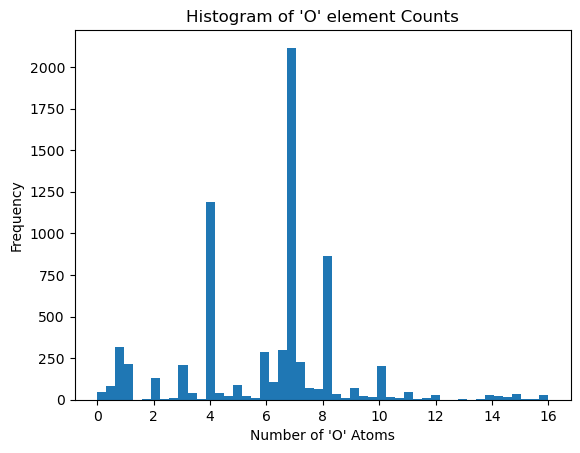

In [36]:
o_counts = []

# Iterate over the list of dictionaries
for material in unique_formulas:
    if 'O' in material:
        o_count = material['O']  # Get the count of 'O' atoms
        o_counts.append(o_count)

# Plot the histogram
plt.hist(o_counts, bins=50,  range=[0,16])
plt.xlabel("Number of 'O' Atoms")
plt.ylabel("Frequency")
plt.title("Histogram of 'O' element Counts")
plt.show()

In [37]:
# We create a list where the oxygen-amounts are rounded if they are within < 0.1 of an integer.
temp = copy.deepcopy(unique_formulas)
oxygen_collapsed_formulas = []

for material in temp:
  oxygen_collapsed_formulas.append(collapse_element(material, 0.1, 'O'))

#### Step 4: Create a df of unique materials and Tc statistics (14070)

In [38]:
# Example of how 'parsed_formula' stores dicts and how to access them.
df_chem_form_clean['formula_dict'][20]['O']

4.0

In [39]:
import ast

# Convert dictionaries to tuples by sorting the key-value pairs based on the keys and converting the sorted key-value pairs into a tuple.
df_chem_form_clean['parsed_formula_tuple'] = df_chem_form_clean['formula_dict'].apply(lambda d: tuple(sorted(d.items())))

# Group the dataframe by the unique parsed_formula tuples
grouped = df_chem_form_clean.groupby('parsed_formula_tuple')

# Create empty lists to store the statistics
sc_ids = []
supercon_formulas = []
cleaned_formulas = []
unique_materials = []
highest_tcs = []
average_tcs = []
std_tcs = []
entry_counts = []


# Iterate over each unique material group
for material_tuple, group in grouped:

    # Convert the tuple back to a dictionary
    material_dict = dict(material_tuple)

    # Extract the Tc values for the current material group
    tcs = group['Tc'].tolist()

    # Calculate the statistics
    highest_tc = np.max(tcs)
    average_tc = np.mean(tcs)
    std_tc = np.std(tcs)
    entry_count = len(group)

    # Append the material, statistics, entry count, and original parsed_formula to the lists
    sc_ids.append(group['sc_id'].tolist())
    supercon_formulas.append(group['supercon_formula'].tolist()[0])
    cleaned_formulas.append(group['clean_formula'].tolist()[0])
    unique_materials.append(material_dict)
    highest_tcs.append(highest_tc)
    average_tcs.append(average_tc)
    std_tcs.append(std_tc)
    entry_counts.append(entry_count)



# Create a new dataframe with the unique materials and associated statistics
unique_mat_df = pd.DataFrame({
    'sc_id':sc_ids,
    'supercon_formula':supercon_formulas,
    'cleaned_formula': cleaned_formulas,
    'material_dict': unique_materials,
    'highest_Tc': highest_tcs,
    'average_Tc': average_tcs,
    'std_Tc': std_tcs,
    'entry_count': entry_counts,
})

unique_mat_df.head(20)

,sc_id,supercon_formula,cleaned_formula,material_dict,highest_Tc,average_Tc,std_Tc,entry_count
0,[12787],Ag0.002Al0.998,Ag0.002Al0.998,"{'Ag': 0.002, 'Al': 0.998}",1.128,1.128,0.00,1
1,[12816],Ag0.005Zn0.995,Ag0.005Zn0.995,"{'Ag': 0.005, 'Zn': 0.995}",0.763,0.763,0.00,1
2,[25145],Bi3.99Ag0.01S3O4,Bi3.99Ag0.01S3O4,"{'Ag': 0.01, 'Bi': 3.99, 'O': 4.0, 'S': 3.0}",4.310,4.310,0.00,1
3,[23179],Sr1Pd1.98Ag0.02Ge2,Sr1Pd1.98Ag0.02Ge2,"{'Ag': 0.02, 'Ge': 2.0, 'Pd': 1.98, 'Sr': 1.0}",2.640,2.640,0.00,1
4,[25146],Bi3.97Ag0.03S3O4,Bi3.97Ag0.03S3O4,"{'Ag': 0.03, 'Bi': 3.97, 'O': 4.0, 'S': 3.0}",4.200,4.200,0.00,1
5,[14866],Ag0.03Tl0.97,Ag0.03Tl0.97,"{'Ag': 0.03, 'Tl': 0.97}",2.670,2.670,0.00,1
6,[12794],Ag0.035Cd0.01Sn0.955,Ag0.035Cd0.01Sn0.955,"{'Ag': 0.035, 'Cd': 0.01, 'Sn': 0.955}",3.650,3.650,0.00,1
7,[13],Ba0.1La1.9Ag0.05Cu0.95O4-Y,Ba0.1La1.9Ag0.05Cu0.95O4,"{'Ag': 0.05, 'Ba': 0.1, 'Cu': 0.95, 'La': 1.9,...",27.000,27.000,0.00,1
8,[25147],Bi3.95Ag0.05S3O4,Bi3.95Ag0.05S3O4,"{'Ag': 0.05, 'Bi': 3.95, 'O': 4.0, 'S': 3.0}",3.520,3.520,0.00,1
9,[12802],Ag0.05Rh0.04Ti0.91,Ag0.05Rh0.04Ti0.91,"{'Ag': 0.05, 'Rh': 0.04, 'Ti': 0.91}",1.950,1.950,0.00,1


In [40]:
unique_mat_df.to_json('unique_materials_14k.json')

#### Step 5: Non-fractional element-number materials (2105)

In [41]:
# Filter the dataframe to include entries with whole number values for all keys
df_non_doped_materials = unique_mat_df[unique_mat_df['material_dict'].apply(lambda d: all(value.is_integer() for value in d.values()))]
df_non_doped_materials = df_non_doped_materials.reset_index(drop=True)

SyntaxError: invalid syntax (2482855248.py, line 5)

In [ ]:
df_non_doped_materials.shape

(2105, 8)

In [ ]:
df_non_doped_materials.to_json('non_doped_materials.json')

## **C: MaterialsProject Integration**

### **Basic Setup:**

In [ ]:
# Installs the API of the Materials Project.
!pip install mp_api

In [ ]:
# See link https://workshop.materialsproject.org/lessons/04_materials_api/MAPI%20Lesson%20%28filled%29/ for a tutorial.
from mp_api.client import MPRester

### **Query MaterialsProject for our unique materials**

#### Basic Examples:

In [ ]:
# This will take a chemys argument (see docs) but this is not great because we want to use the dict...
with MPRester("KW2m7Cp4Xm5qNFwmnp2Xas8kfB8ILxuy") as mpr:
  docs = mpr.summary.search(chemsys="Ti-Pd")
# Example of something useful:
# It returns a LIST of dicts, even though that list has a length of 1. We then take the composition attribute, which is formatted as a dict. The value of the key "Al" in this material is 16.

print(docs[0].structure)

C:\Users\Droor\anaconda3\lib\site-packages\mp_api\client\mprester.py:182: UserWarning: mpcontribs-client not installed. Install the package to query MPContribs data, or construct pourbaix diagrams: 'pip install mpcontribs-client'
  warnings.warn(


Retrieving SummaryDoc documents:   0%|          | 0/14 [00:00<?, ?it/s]

Full Formula (Ti2 Pd1)
Reduced Formula: Ti2Pd
abc   :   3.107432   3.107432   5.422457
angles: 106.650549 106.650536  89.999996
pbc   :       True       True       True
Sites (3)
  #  SP           a         b          c    magmom
---  ----  --------  --------  ---------  --------
  0  Ti    0.664317  0.664317   0.328636         0
  1  Ti    0.335683  0.335683   0.671364         0
  2  Pd    0         0         -0               -0


In [ ]:
# This will take a chemys argument (see docs) but this is not great because we want to use the dict...
with MPRester("KW2m7Cp4Xm5qNFwmnp2Xas8kfB8ILxuy") as mpr:
    docs = mpr.thermo.search(chemsys="Cu-O")

# There is no field relating to thermal conductivity. https://api.materialsproject.org/docs#/Materials%20Thermo/search_materials_thermo__get

Retrieving ThermoDoc documents:   0%|          | 0/80 [00:00<?, ?it/s]

For more information on the summary.search function, don't bother with the API documentation, but look at the actual code of it: https://github.com/materialsproject/api/blob/bc5a9fb7309a7b5eb77bb1dc5956d2d6307df345/mp_api/client/routes/summary.py#L34-L170

We are kind of in luck. The 'Composition' field is formatted in the same way we have formatted our dicts.

#### Approach 2 (Winner) : using the elements in the formula -- and then filtering by SummaryDoc composition and our dict.

In [ ]:
!pip install gemmi

In [ ]:
import sys

# Add the folder path to the system path
sys.path.append("C:/Users/Droor/OneDrive - Harvard University/Desktop/Master Folder/College (2022-2026)/Hoffman summer/git-clone/superconductors-ml/data-prep/3DSC")

from superconductors_3D.dataset_preparation.utils.check_dataset import if_valid_formula, set_column_type, correct_symmetry_cell_setting, extract_float_values, standardise_chem_formula, get_chem_dict, consistent_spacegroup_and_crystal_system, get_normalised_spg, check_and_complement_structure, filter_entries, get_chemical_composition, normalise_pymatgen_spacegroups, normalise_AFLOW_prototype_spacegroups, normalise_quantities, prepare_df_sc, normalise_chemdict

In [ ]:
# Other approaches I tried but didn't get far: 1) using just the composition dict that we have. 2) Using pymatgen and the old API to query materials. 3) Web-scraping using BeautifulSoup.

In [ ]:
# EXAMPLE of using formula elements:
with MPRester("KW2m7Cp4Xm5qNFwmnp2Xas8kfB8ILxuy") as mpr:
  info = mpr.summary.search(elements=['Cu', 'O'], num_elements=2, )
for SumDoc in info:
  print(SumDoc)

Retrieving SummaryDoc documents:   0%|          | 0/37 [00:00<?, ?it/s]

MPDataDoc<SummaryDoc>
builder_meta=EmmetMeta(emmet_version='0.38.6', pymatgen_version='2022.10.22', pull_request=825, database_version='2022.10.28', build_date=datetime.datetime(2022, 10, 28, 0, 53, 57, 384000)),
nsites=14,
elements=[Element Cu, Element O],
nelements=2,
composition=Comp: Cu8 O6,
composition_reduced=Comp: Cu4 O3,
formula_pretty='Cu4O3',
formula_anonymous='A3B4',
chemsys='Cu-O',
volume=165.84962311746813,
density=6.051088195427847,
density_atomic=11.846401651247723,
symmetry=SymmetryData(crystal_system=<CrystalSystem.tet: 'Tetragonal'>, symbol='I4_1/amd', number=141, point_group='4/mmm', symprec=0.1, version='1.16.2'),
property_name='summary',
material_id=MPID(mp-1478),
deprecated=False,
deprecation_reasons=None,
last_updated=datetime.datetime(2022, 10, 28, 0, 53, 57, 385000),
origins=[],
warnings=[],
structure=Structure Summary
Lattice
    abc : 5.790599580458261 5.790581248923908 6.4222772718036945
 angles : 116.80543811261684 116.80543234590041 90.01732266559291
 volu

In [ ]:
# Simple EXAMPLE of the difference between stable chemical systems and unstable ones.
#
# with MPRester("KW2m7Cp4Xm5qNFwmnp2Xas8kfB8ILxuy") as mpr:
#   l1 = mpr.summary.search(elements=['Te','Ag'], num_elements=2)
#   print(len(l1))
#   for i in range(len(l1)):
#     print(l1[i].composition.as_dict())
#
#   l2 = mpr.summary.search(elements=['Te','Ag'], num_elements=2, is_stable=True)
#   print(len(l2))
#   for i in range(len(l2)):
#     print(l2[i].composition.as_dict())

In [ ]:
normalise_chemdict({'Ag': 35.0, 'Te': 20.0}, {'Ag': 7, 'Te': 4})


{'Ag': 7.0, 'Te': 4.0}

Here we try to query the MP api by element and num_element, and then we filter the results we get out by their composition so we can get to the exact dict of species and numbers specified.

! Takes 30+m to run

In [ ]:
# dict_requested = []
# all_elem_matches = []
# dict_matches = []
# mp_id = []
# volumes = []
#
# # Iterate over every entry in SuperCon
# for index, row in df_non_doped_materials.head(20).iterrows():
#
#     # temp variables
#     list_elements = []
#     list_formulas1 = []
#     list_formulas2 = []
#     l1 = []
#     l2 = []
#
#     dict_asked = row["material_dict"]
#
#     # Store the element-keys as a list
#     for key in dict_asked.keys():
#         list_elements.append(key)
#
#     with MPRester("KW2m7Cp4Xm5qNFwmnp2Xas8kfB8ILxuy") as mpr:
#         docs = mpr.summary.search(elements=list_elements, num_elements=len(list_elements))
#
#     # Iterate over every material the MP returns (so one by one in a list)
#     for SumDoc in docs:
#         dict_back_normalized = normalise_chemdict(SumDoc.composition.as_dict(), dict_asked)
#         print('MP entry' + str(SumDoc.composition.as_dict()))
#         print('dict queried' + str(dict_asked))
#         print('Normalized entry' + str(dict_back_normalized))
#         n_factor = list(dict_back_normalized.values())[0] / list(dict_asked.values())[0]
#         print(str(n_factor))
#         print(SumDoc.material_id)
#
#         if dict_back_normalized == dict_asked:
#             l1.append(SumDoc.material_id)
#             l2.append(SumDoc.volume)
#             list_formulas1.append(SumDoc.formula_pretty)
#         list_formulas2.append(SumDoc.formula_pretty)
#
#     # Add those pretty formulae to our big list
#     dict_requested.append(dict_asked)
#     dict_matches.append(list_formulas1)
#     all_elem_matches.append(list_formulas2)
#     mp_id.append(l1)
#     volumes.append(l2)
#
# # Create a new database
# df_stable_mp_matches = df_non_doped_materials.head(20)
#
# df_stable_mp_matches['material_dict_queried'] = dict_requested
# df_stable_mp_matches['matches_by_element'] = all_elem_matches
# df_stable_mp_matches['matches_by_dict'] = dict_matches
# df_stable_mp_matches['mp_ids'] = mp_id
# df_stable_mp_matches['unit_cell_volumes'] = volumes
#
# df_stable_mp_matches.head(10)
# #df_stable_mp_matches.to_csv('df_stable_matches2.csv')

C:\Users\Droor\anaconda3\lib\site-packages\mp_api\client\mprester.py:182: UserWarning: mpcontribs-client not installed. Install the package to query MPContribs data, or construct pourbaix diagrams: 'pip install mpcontribs-client'
  warnings.warn(


Retrieving SummaryDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'B': 2.0})
dict queried{'Ag': 1.0, 'B': 2.0}
Normalized entry{'Ag': 1.0, 'B': 2.0}
1.0
mp-12062


Retrieving SummaryDoc documents: 0it [00:00, ?it/s]

Retrieving SummaryDoc documents: 0it [00:00, ?it/s]

Retrieving SummaryDoc documents: 0it [00:00, ?it/s]

Retrieving SummaryDoc documents: 0it [00:00, ?it/s]

Retrieving SummaryDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ag': 3.0, 'Bi': 1.0})
dict queried{'Ag': 1.0, 'Bi': 1.0}
Normalized entry{'Ag': 1.5, 'Bi': 0.5}
1.5
mp-1229111


Retrieving SummaryDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ag': 3.0, 'Bi': 1.0})
dict queried{'Ag': 1.0, 'Bi': 2.0}
Normalized entry{'Ag': 2.25, 'Bi': 0.75}
2.25
mp-1229111


Retrieving SummaryDoc documents: 0it [00:00, ?it/s]

Retrieving SummaryDoc documents: 0it [00:00, ?it/s]

Retrieving SummaryDoc documents:   0%|          | 0/11 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'In': 18.0, 'Ag': 34.0})
dict queried{'Ag': 1.0, 'In': 2.0}
Normalized entry{'In': 1.0384615384615385, 'Ag': 1.9615384615384617}
1.0384615384615385
mp-1224231
MP entrydefaultdict(<class 'float'>, {'In': 1.0, 'Ag': 3.0})
dict queried{'Ag': 1.0, 'In': 2.0}
Normalized entry{'In': 0.75, 'Ag': 2.25}
0.75
mp-1223839
MP entrydefaultdict(<class 'float'>, {'In': 1.0, 'Ag': 3.0})
dict queried{'Ag': 1.0, 'In': 2.0}
Normalized entry{'In': 0.75, 'Ag': 2.25}
0.75
mp-30343
MP entrydefaultdict(<class 'float'>, {'In': 3.0, 'Ag': 1.0})
dict queried{'Ag': 1.0, 'In': 2.0}
Normalized entry{'In': 2.25, 'Ag': 0.75}
2.25
mp-1184493
MP entrydefaultdict(<class 'float'>, {'In': 16.0, 'Ag': 36.0})
dict queried{'Ag': 1.0, 'In': 2.0}
Normalized entry{'In': 0.9230769230769231, 'Ag': 2.076923076923077}
0.9230769230769231
mp-21975
MP entrydefaultdict(<class 'float'>, {'In': 1.0, 'Ag': 3.0})
dict queried{'Ag': 1.0, 'In': 2.0}
Normalized entry{'In': 0.75, 'Ag': 2.25}
0.75
mp-1223787

Retrieving SummaryDoc documents:   0%|          | 0/6 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'La': 1.0, 'Ag': 1.0})
dict queried{'Ag': 1.0, 'La': 1.0}
Normalized entry{'La': 1.0, 'Ag': 1.0}
1.0
mp-1948
MP entrydefaultdict(<class 'float'>, {'La': 6.0, 'Ag': 2.0})
dict queried{'Ag': 1.0, 'La': 1.0}
Normalized entry{'La': 1.5, 'Ag': 0.5}
1.5
mp-978254
MP entrydefaultdict(<class 'float'>, {'La': 2.0, 'Ag': 10.0})
dict queried{'Ag': 1.0, 'La': 1.0}
Normalized entry{'La': 0.3333333333333333, 'Ag': 1.6666666666666665}
0.3333333333333333
mp-1223062
MP entrydefaultdict(<class 'float'>, {'La': 1.0, 'Ag': 3.0})
dict queried{'Ag': 1.0, 'La': 1.0}
Normalized entry{'La': 0.5, 'Ag': 1.5}
0.5
mp-1185024
MP entrydefaultdict(<class 'float'>, {'La': 3.0, 'Ag': 1.0})
dict queried{'Ag': 1.0, 'La': 1.0}
Normalized entry{'La': 1.5, 'Ag': 0.5}
1.5
mp-1184993
MP entrydefaultdict(<class 'float'>, {'La': 2.0, 'Ag': 4.0})
dict queried{'Ag': 1.0, 'La': 1.0}
Normalized entry{'La': 0.6666666666666666, 'Ag': 1.3333333333333333}
0.6666666666666666
mp-1025059


Retrieving SummaryDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'Mo': 6.0, 'S': 8.0})
dict queried{'Ag': 1.0, 'Mo': 4.0, 'S': 5.0}
Normalized entry{'Ag': 0.6666666666666666, 'Mo': 4.0, 'S': 5.333333333333333}
0.6666666666666666
mp-35109


Retrieving SummaryDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'Mo': 6.0, 'S': 8.0})
dict queried{'Ag': 1.0, 'Mo': 6.0, 'S': 8.0}
Normalized entry{'Ag': 1.0, 'Mo': 6.0, 'S': 8.0}
1.0
mp-35109


Retrieving SummaryDoc documents: 0it [00:00, ?it/s]

Retrieving SummaryDoc documents:   0%|          | 0/3 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ag': 16.0, 'Sn': 2.0, 'Se': 12.0})
dict queried{'Ag': 1.0, 'Se': 2.0, 'Sn': 1.0}
Normalized entry{'Ag': 2.1333333333333333, 'Sn': 0.26666666666666666, 'Se': 1.6}
2.1333333333333333
mp-17984
MP entrydefaultdict(<class 'float'>, {'Ag': 16.0, 'Sn': 8.0, 'Se': 24.0})
dict queried{'Ag': 1.0, 'Se': 2.0, 'Sn': 1.0}
Normalized entry{'Ag': 1.3333333333333333, 'Sn': 0.6666666666666666, 'Se': 2.0}
1.3333333333333333
mp-1096812
MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'Sn': 1.0, 'Se': 2.0})
dict queried{'Ag': 1.0, 'Se': 2.0, 'Sn': 1.0}
Normalized entry{'Ag': 1.0, 'Sn': 1.0, 'Se': 2.0}
1.0
mp-1229011


Retrieving SummaryDoc documents:   0%|          | 0/10 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ag': 35.0, 'Te': 20.0})
dict queried{'Ag': 1.0, 'Te': 3.0}
Normalized entry{'Ag': 2.5454545454545454, 'Te': 1.4545454545454546}
2.5454545454545454
mp-28228
MP entrydefaultdict(<class 'float'>, {'Ag': 4.0, 'Te': 2.0})
dict queried{'Ag': 1.0, 'Te': 3.0}
Normalized entry{'Ag': 2.6666666666666665, 'Te': 1.3333333333333333}
2.6666666666666665
mp-32811
MP entrydefaultdict(<class 'float'>, {'Ag': 2.0, 'Te': 1.0})
dict queried{'Ag': 1.0, 'Te': 3.0}
Normalized entry{'Ag': 2.6666666666666665, 'Te': 1.3333333333333333}
2.6666666666666665
mp-1229101
MP entrydefaultdict(<class 'float'>, {'Ag': 8.0, 'Te': 4.0})
dict queried{'Ag': 1.0, 'Te': 3.0}
Normalized entry{'Ag': 2.6666666666666665, 'Te': 1.3333333333333333}
2.6666666666666665
mp-684798
MP entrydefaultdict(<class 'float'>, {'Ag': 8.0, 'Te': 4.0})
dict queried{'Ag': 1.0, 'Te': 3.0}
Normalized entry{'Ag': 2.6666666666666665, 'Te': 1.3333333333333333}
2.6666666666666665
mp-1247858
MP entrydefaultdict(<class '

Retrieving SummaryDoc documents:   0%|          | 0/2 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Tl': 3.0, 'Ag': 1.0})
dict queried{'Ag': 1.0, 'Tl': 1.0}
Normalized entry{'Tl': 1.5, 'Ag': 0.5}
1.5
mp-1187490
MP entrydefaultdict(<class 'float'>, {'Tl': 3.0, 'Ag': 1.0})
dict queried{'Ag': 1.0, 'Tl': 1.0}
Normalized entry{'Tl': 1.5, 'Ag': 0.5}
1.5
mp-1187545


Retrieving SummaryDoc documents:   0%|          | 0/3 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ce': 2.0, 'Si': 4.0, 'Ag': 2.0})
dict queried{'Ag': 2.0, 'Ce': 1.0, 'Si': 2.0}
Normalized entry{'Ce': 1.25, 'Si': 2.5, 'Ag': 1.25}
0.625
mp-1080480
MP entrydefaultdict(<class 'float'>, {'Ce': 1.0, 'Si': 2.0, 'Ag': 2.0})
dict queried{'Ag': 2.0, 'Ce': 1.0, 'Si': 2.0}
Normalized entry{'Ce': 1.0, 'Si': 2.0, 'Ag': 2.0}
0.5
mp-5605
MP entrydefaultdict(<class 'float'>, {'Ce': 1.0, 'Si': 1.0, 'Ag': 1.0})
dict queried{'Ag': 2.0, 'Ce': 1.0, 'Si': 2.0}
Normalized entry{'Ce': 1.6666666666666667, 'Si': 1.6666666666666667, 'Ag': 1.6666666666666667}
0.8333333333333334
mp-1226539


Retrieving SummaryDoc documents:   0%|          | 0/9 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ag': 6.0, 'F': 18.0})
dict queried{'Ag': 2.0, 'F': 1.0}
Normalized entry{'Ag': 0.75, 'F': 2.25}
0.375
mp-18536
MP entrydefaultdict(<class 'float'>, {'Ag': 6.0, 'F': 16.0})
dict queried{'Ag': 2.0, 'F': 1.0}
Normalized entry{'Ag': 0.8181818181818181, 'F': 2.1818181818181817}
0.40909090909090906
mp-562412
MP entrydefaultdict(<class 'float'>, {'Ag': 2.0, 'F': 4.0})
dict queried{'Ag': 2.0, 'F': 1.0}
Normalized entry{'Ag': 1.0, 'F': 2.0}
0.5
mp-7715
MP entrydefaultdict(<class 'float'>, {'Ag': 6.0, 'F': 2.0})
dict queried{'Ag': 2.0, 'F': 1.0}
Normalized entry{'Ag': 2.25, 'F': 0.75}
1.125
mp-1183244
MP entrydefaultdict(<class 'float'>, {'Ag': 4.0, 'F': 6.0})
dict queried{'Ag': 2.0, 'F': 1.0}
Normalized entry{'Ag': 1.2, 'F': 1.7999999999999998}
0.6
mp-861945
MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'F': 1.0})
dict queried{'Ag': 2.0, 'F': 1.0}
Normalized entry{'Ag': 1.5, 'F': 1.5}
0.75
mp-7592
MP entrydefaultdict(<class 'float'>, {'Ag': 2.0, 'F': 1.

Retrieving SummaryDoc documents:   0%|          | 0/10 [00:00<?, ?it/s]

MP entrydefaultdict(<class 'float'>, {'Ag': 2.0, 'I': 2.0})
dict queried{'Ag': 2.0, 'I': 1.0}
Normalized entry{'Ag': 1.5, 'I': 1.5}
0.75
mp-22894
MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'I': 1.0})
dict queried{'Ag': 2.0, 'I': 1.0}
Normalized entry{'Ag': 1.5, 'I': 1.5}
0.75
mp-1182980
MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'I': 1.0})
dict queried{'Ag': 2.0, 'I': 1.0}
Normalized entry{'Ag': 1.5, 'I': 1.5}
0.75
mp-684580
MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'I': 1.0})
dict queried{'Ag': 2.0, 'I': 1.0}
Normalized entry{'Ag': 1.5, 'I': 1.5}
0.75
mp-22919
MP entrydefaultdict(<class 'float'>, {'Ag': 2.0, 'I': 2.0})
dict queried{'Ag': 2.0, 'I': 1.0}
Normalized entry{'Ag': 1.5, 'I': 1.5}
0.75
mp-568927
MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'I': 1.0})
dict queried{'Ag': 2.0, 'I': 1.0}
Normalized entry{'Ag': 1.5, 'I': 1.5}
0.75
mp-22915
MP entrydefaultdict(<class 'float'>, {'Ag': 1.0, 'I': 2.0})
dict queried{'Ag': 2.0, 'I': 1.0}
Normalized entry{'Ag': 1.0

,sc_id,supercon_formula,cleaned_formula,material_dict,highest_Tc,average_Tc,std_Tc,entry_count,material_dict_queried,matches_by_element,matches_by_dict,mp_ids,unit_cell_volumes
0,[18852],Ag1B2,Ag1B2,"{'Ag': 1.0, 'B': 2.0}",6.700,6.700,0.00,1,"{'Ag': 1.0, 'B': 2.0}",[AgB2],[AgB2],[mp-12062],[32.243677453380414]
1,[20016],Ag1Ba2Ca2Cu3O9-z,Ag1Ba2Ca2Cu3O9,"{'Ag': 1.0, 'Ba': 2.0, 'Ca': 2.0, 'Cu': 3.0, '...",110.000,110.000,0.00,1,"{'Ag': 1.0, 'Ba': 2.0, 'Ca': 2.0, 'Cu': 3.0, '...",[],[],[],[]
2,[20017],Ag1Ba2Ca3Cu4O11-z,Ag1Ba2Ca3Cu4O11,"{'Ag': 1.0, 'Ba': 2.0, 'Ca': 3.0, 'Cu': 4.0, '...",117.000,117.000,0.00,1,"{'Ag': 1.0, 'Ba': 2.0, 'Ca': 3.0, 'Cu': 4.0, '...",[],[],[],[]
3,[20018],Ag1Ba2Ca4Cu5O13-z,Ag1Ba2Ca4Cu5O13,"{'Ag': 1.0, 'Ba': 2.0, 'Ca': 4.0, 'Cu': 5.0, '...",105.000,105.000,0.00,1,"{'Ag': 1.0, 'Ba': 2.0, 'Ca': 4.0, 'Cu': 5.0, '...",[],[],[],[]
4,[20019],Ag1Ba2Ca5Cu6O15-z,Ag1Ba2Ca5Cu6O15,"{'Ag': 1.0, 'Ba': 2.0, 'Ca': 5.0, 'Cu': 6.0, '...",80.000,80.000,0.00,1,"{'Ag': 1.0, 'Ba': 2.0, 'Ca': 5.0, 'Cu': 6.0, '...",[],[],[],[]
5,[14670],Ag1Bi1,Ag1Bi1,"{'Ag': 1.0, 'Bi': 1.0}",2.780,2.780,0.00,1,"{'Ag': 1.0, 'Bi': 1.0}",[Ag3Bi],[],[],[]
6,[12785],Ag1Bi2,Ag1Bi2,"{'Ag': 1.0, 'Bi': 2.0}",3.000,3.000,0.00,1,"{'Ag': 1.0, 'Bi': 2.0}",[Ag3Bi],[],[],[]
7,[25718],La2Bi3Ag1S6O2,La2Bi3Ag1S6O2,"{'Ag': 1.0, 'Bi': 3.0, 'La': 2.0, 'O': 2.0, 'S...",0.500,0.500,0.00,1,"{'Ag': 1.0, 'Bi': 3.0, 'La': 2.0, 'O': 2.0, 'S...",[],[],[],[]
8,[23623],Pb4Ag1Bi6Se14,Pb4Ag1Bi6Se14,"{'Ag': 1.0, 'Bi': 6.0, 'Pb': 4.0, 'Se': 14.0}",1.075,1.075,0.00,1,"{'Ag': 1.0, 'Bi': 6.0, 'Pb': 4.0, 'Se': 14.0}",[],[],[],[]
9,"[14632, 14868]",Ag1In2,Ag1In2,"{'Ag': 1.0, 'In': 2.0}",2.400,2.350,0.05,2,"{'Ag': 1.0, 'In': 2.0}","[In9Ag17, InAg3, InAg3, In3Ag, In4Ag9, InAg3, ...","[In2Ag, In2Ag]","[mp-19974, mp-760385]","[134.3673655271227, 154.40892455106493]"


In [ ]:
# Read the .csv file I got from the above code into a dataframe
df_unstable_mp_matches = pd.read_excel("C:/Users/Droor/OneDrive - Harvard University/Desktop/Master Folder/College (2022-2026)/Hoffman summer/git-clone/superconductors-ml/datasets/all_mp_matches.xlsx")

In [ ]:
# # STORE the file in a non-loss way.
# import pickle

# # Using pickle serialization!
# with open('dataframe.pickle', 'wb') as file:
#     pickle.dump(df_unstable_mp_matches, file)
# # To read the file later
# # with open('dataframe.pickle', 'rb') as file:
# #     df = pickle.load(file)


# df_stable_mp_matches.to_json('df_stable_mp_matches.json')
# # df = pd.read_json('dataframe.json')

In [ ]:
# Create a histogram of how many MP entries are returned to us.
plt.hist(len(str(df_unstable_mp_matches['mp_ids'])), bins=10, edgecolor='black')

# Customize the plot
plt.xlabel('Number of Entries')
plt.ylabel('Frequency')
plt.title('Histogram of Number of Entries in "id" Column')

# Display the histogram
plt.show()

In [ ]:
# How many of our queried materials have an MP entry?
len(df_unstable_mp_matches[df_unstable_mp_matches['mp_ids'].str.len() > 2])

So we only have 1208 of our 2100 materials (stable and unstable)

Now we do the same database query, but we only take materials that are stable.